<a href="https://colab.research.google.com/github/CherryProgger/electro/blob/main/Electro.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
! pip install catboost

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 98.7/98.7 MB 7.8 MB/s eta 0:00:00


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
data_path = '/content/drive/MyDrive/data_el/'

repair_path = f'{data_path}Ремонты.csv'

payload_path = f'{data_path}Нагрузка на эл..csv'

In [ ]:
import pandas as pd

repair = pd.read_csv(repair_path)

payload = pd.read_csv(payload_path)

payload.drop(['month', 'year',], axis=1, inplace = True)

payload['share'] = pd.to_numeric(payload['share'], errors = 'coerce') #Переводим строковые данные в числовые, в случае ошибки будет NaN

payload[-7250:-7200]

,dt,el,anod,el_anod,pres,priznak,share,el_pres_sum,break_count,probeg,dt_zamer,part,covers_count,cover_num,row,is_break
130414,2023-03-01,69,23,69_23,940.0,работает,0.072581,12951.0,1.0,4488.0,NaN,NaN,4,4,4,работает
130415,2023-03-01,102,23,102_23,740.0,работает,0.054974,13461.0,1.0,3384.0,NaN,NaN,4,4,4,не работал
130416,2023-03-01,103,23,103_23,560.0,работает,0.042264,13250.0,0.0,7536.0,NaN,NaN,4,4,4,не работал
130417,2023-03-01,104,23,104_23,870.0,работает,0.065755,13231.0,2.0,120.0,NaN,NaN,4,4,4,работает
130418,2023-03-01,105,23,105_23,720.0,работает,0.054874,13121.0,1.0,12120.0,NaN,NaN,4,4,4,работает
130419,2023-03-01,106,23,106_23,610.0,работает,0.045899,13290.0,0.0,2064.0,NaN,NaN,4,4,4,не работал
130420,2023-03-01,70,23,70_23,580.0,работает,0.044073,13160.0,0.0,888.0,NaN,NaN,4,4,4,работает
130421,2023-03-01,72,23,72_23,630.0,работает,0.048679,12942.0,2.0,5520.0,NaN,NaN,4,4,4,работает
130422,2023-03-01,73,23,73_23,700.0,работает,0.051806,13512.0,2.0,28992.0,NaN,NaN,4,4,4,работает
130423,2023-03-01,74,23,74_23,400.0,работает,0.026720,14970.0,0.0,14904.0,NaN,NaN,4,4,4,не работал


In [ ]:
payload[payload['el_anod'] == '28а_7']

,dt,el,anod,el_anod,pres,priznak,share,el_pres_sum,break_count,probeg,dt_zamer,part,covers_count,cover_num,row,is_break
34452,2019-07-01,28а,7,28а_7,490.0,работает,0.048630,10076.0,1.0,NaN,NaN,NaN,2,1,3,не работал
34540,2019-08-01,28а,7,28а_7,490.0,работает,0.048371,10130.0,2.0,NaN,NaN,NaN,2,1,3,не работал
34629,2019-09-01,28а,7,28а_7,230.0,работает,0.049009,4693.0,3.0,NaN,NaN,NaN,2,1,3,не работал
34719,2019-10-01,28а,7,28а_7,250.0,работает,0.026227,9532.0,2.0,NaN,NaN,NaN,2,1,3,не работал
34813,2019-11-01,28а,7,28а_7,280.0,работает,0.030431,9201.0,1.0,NaN,NaN,NaN,2,1,3,не работал
34912,2019-12-01,28а,7,28а_7,150.0,работает,0.016317,9193.0,3.0,NaN,NaN,NaN,2,1,3,не работал
35010,2020-01-01,28а,7,28а_7,230.0,работает,0.020259,11353.0,3.0,NaN,NaN,NaN,2,1,3,не работал
35108,2020-02-01,28а,7,28а_7,360.0,работает,0.035391,10172.0,2.0,NaN,NaN,NaN,2,1,3,не работал
35308,2020-04-01,28а,7,28а_7,320.0,работает,0.029012,11030.0,0.0,NaN,NaN,NaN,2,1,3,не работал
35408,2020-05-01,28а,7,28а_7,250.0,работает,0.027624,9050.0,0.0,NaN,NaN,NaN,2,1,3,не работал


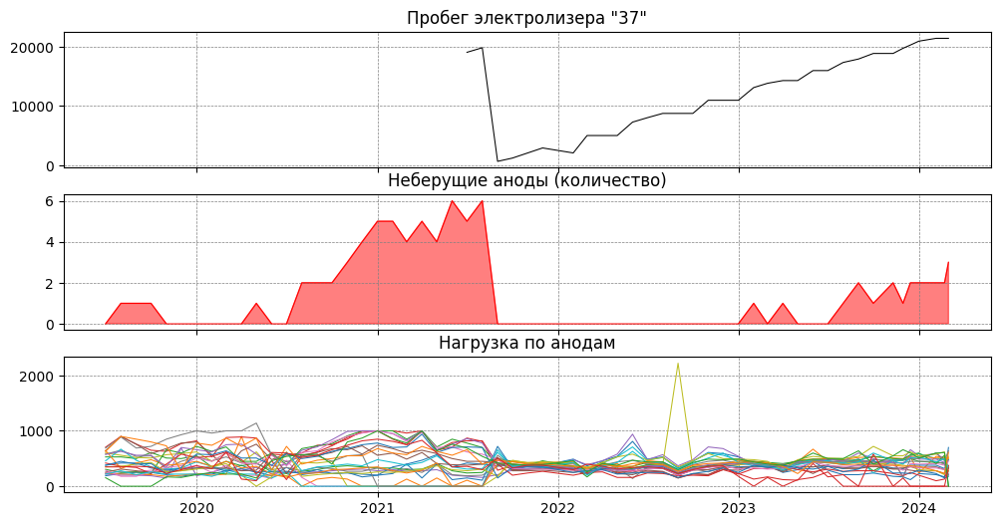

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

def DrawPropChange(el, prop):
  el_test = payload[payload['el'] == el].sort_values(by='dt')
  anodes = set(el_test.anod)
  for anod in anodes:
    anod_df = el_test[el_test['anod'] == anod]
    anod_df.reset_index(drop=True, inplace = True)
    anod_df[prop].plot()

#    payload[(payload['el'] == '28а') & (payload['anod'] == anod)].sort_values(by='dt').share.plot()
  return el_test

#Средняя нагрузка всех работающих анодов
def AvgPress(el_date_test):
  working_press = [pres for pres, work in zip(el_date_test.pres, el_date_test.is_break) if work == 'работает']
  return len(working_press) == 0 and 0 or sum(working_press)/len(working_press)

def AvgPressN(el_date_test, num):
  working_press = sorted([pres for pres, work in zip(el_date_test.pres, el_date_test.is_break) if work == 'работает'])
  print(sum(working_press[:-num]))
  return max(working_press)

#------------------------
def DrawElState(el):
  #Фильтруем данные по конкретному электролизеру и сортируем все измерения по дате
  el_test = payload[payload['el'] == el].sort_values(by='dt')
  el_test.reset_index(drop=True, inplace = True)
  el_test.index = pd.to_datetime(el_test.dt)
  all_dates = sorted(set(el_test.dt))
#  avg_press = pd.DataFrame([(date, AvgPress(el_test[el_test.dt == date])) for date in all_dates], columns = ['dt', 'avg_press'])
#  avg_press = pd.DataFrame([(date, AvgPressN(el_test[el_test.dt == date], 4)) for date in all_dates], columns = ['dt', 'avg_press'])
#  avg_press.index = pd.to_datetime(avg_press.dt)
#  print(avg_press)

  #Отрисовка основных параметров по электролизеру: пробег, кол-во неберущих анодов и нагрузок по каждому аноду
  fig, [axMileage, axBreak, axShare] = plt.subplots(3, 1, figsize=(12, 6), sharex=True)

  axMileage.plot(el_test.index, el_test['probeg'], color = 'black', linewidth=0.75)
  axBreak.plot(el_test.index, el_test['break_count'], color = 'r', linewidth=0.75)
  axBreak.fill_between(el_test.index, el_test['break_count'], 0, where = (el_test['break_count'] > 0),  color = 'r', alpha = 0.5, interpolate=True)

  for ax, title in zip([axMileage, axBreak, axShare], [f'Пробег электролизера "{el}"', 'Неберущие аноды (количество)', 'Нагрузка по анодам']):
    ax.grid(True, linestyle='--', linewidth=0.5, color='gray')
    ax.set_title(title)

  anodes = set(el_test.anod) #Все аноды электролизера
  #Цикл по каждому аноду электролизера
  for anod in anodes:
    anod_df = el_test[el_test['anod'] == anod]
    anod_df.reset_index(drop=True, inplace = True)
    anod_df.index = pd.to_datetime(anod_df.dt)
    axShare.plot(anod_df.index, anod_df['pres'], linewidth=0.75)
#  axShare.plot(avg_press.index, avg_press['avg_press'], linewidth=1, color = 'b')

  return el_test

df = DrawElState('37')


<ipython-input-16-2db16c7ce31f>:38: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, [axMileage, axBreak, axShare] = plt.subplots(3, 1, figsize=(12, 6), sharex=True)


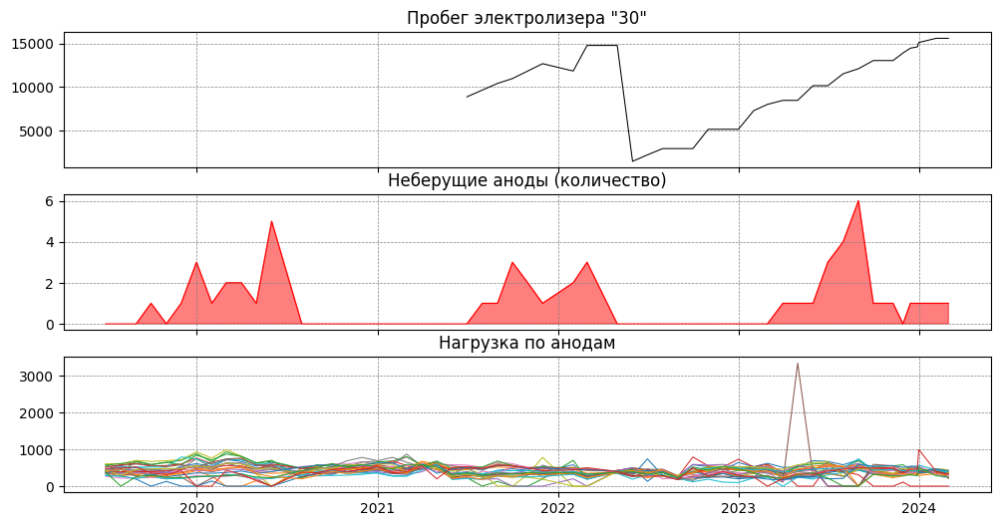

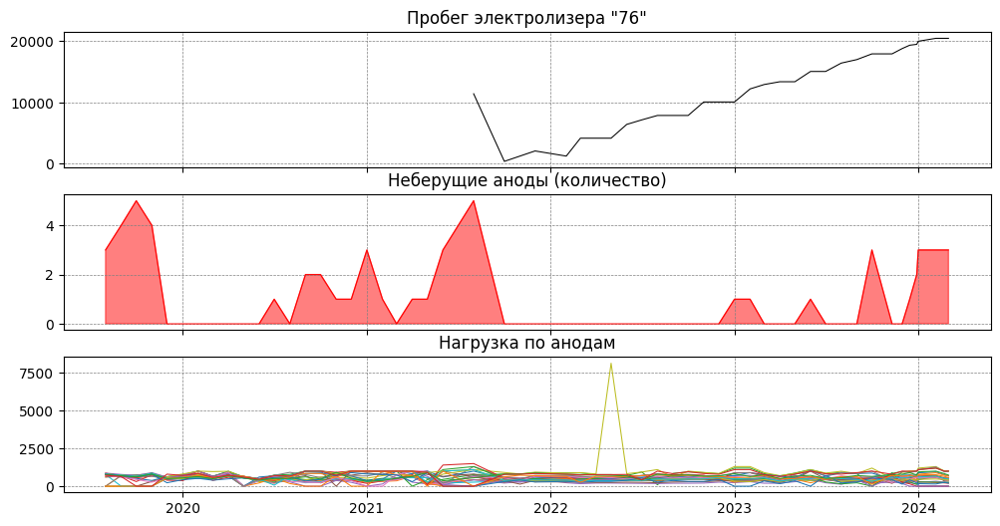

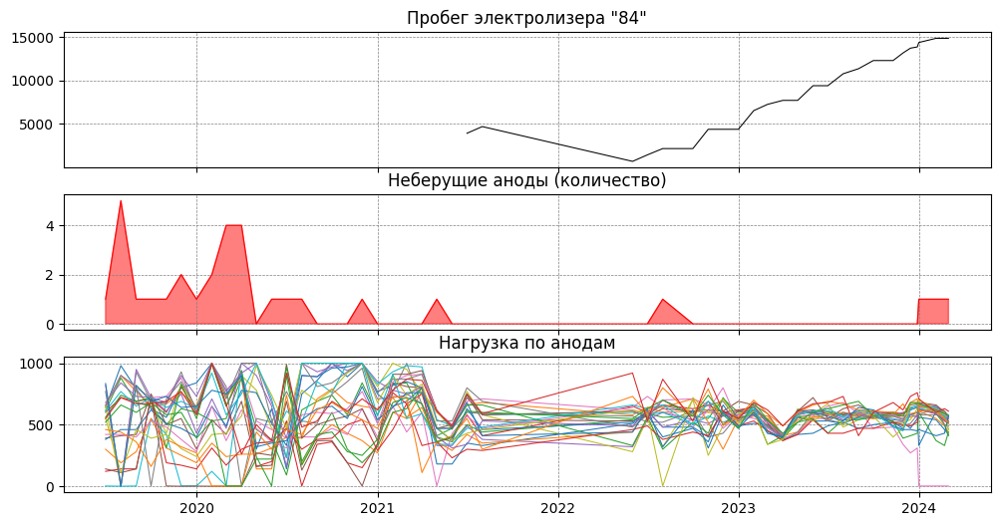

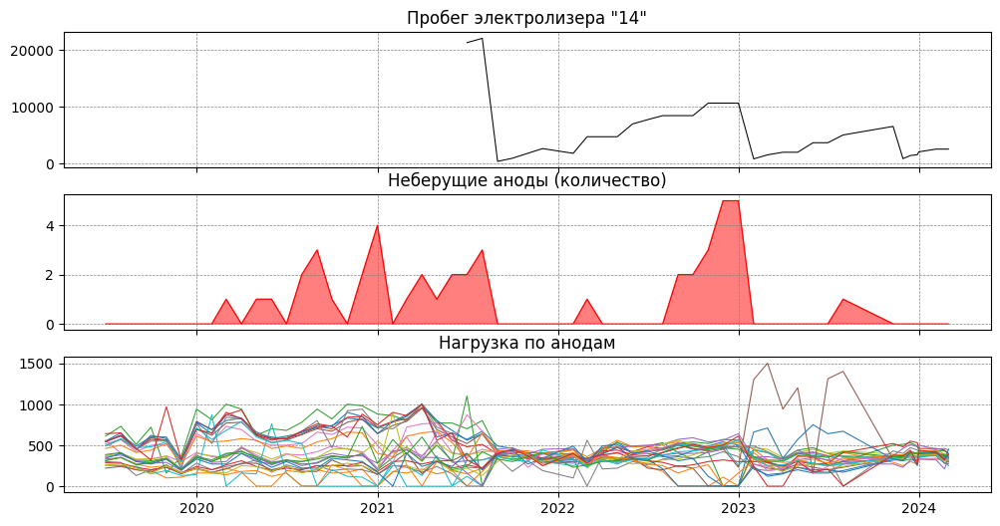

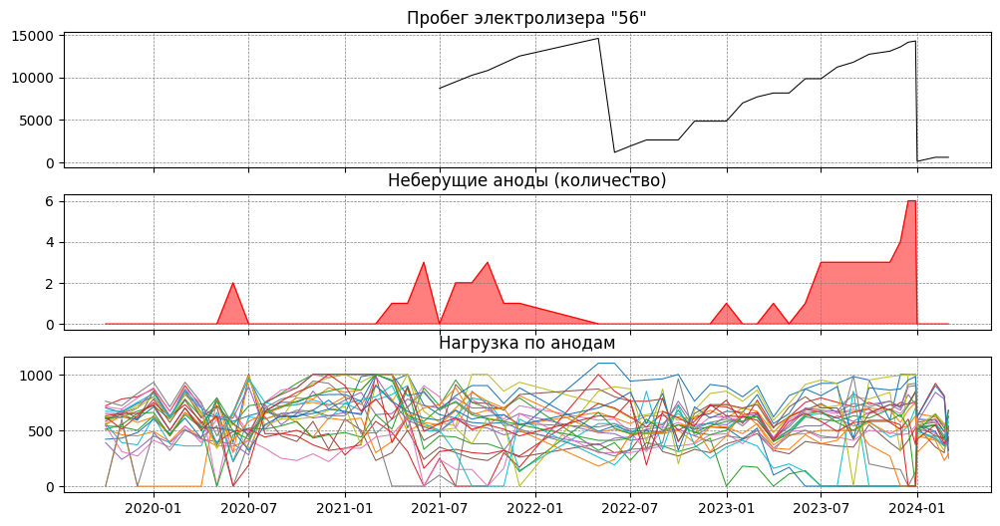

...

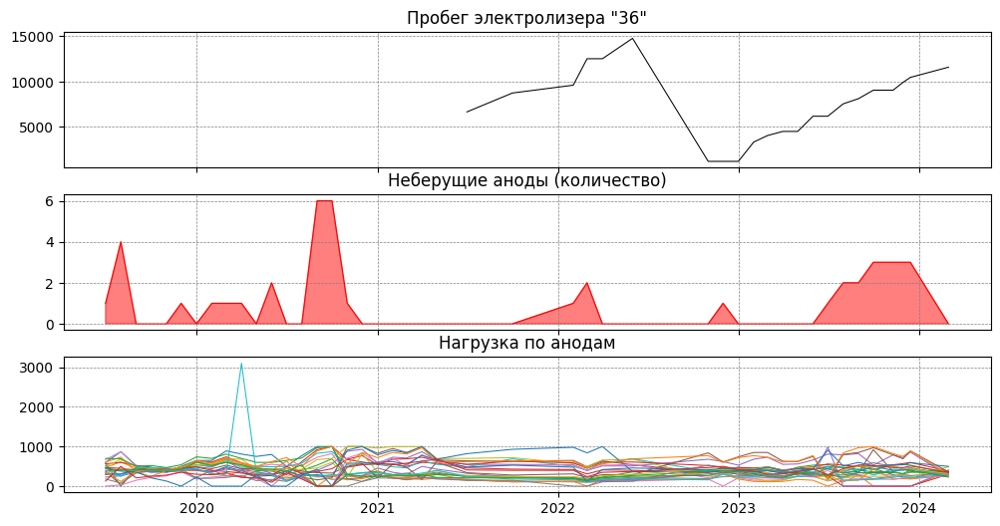

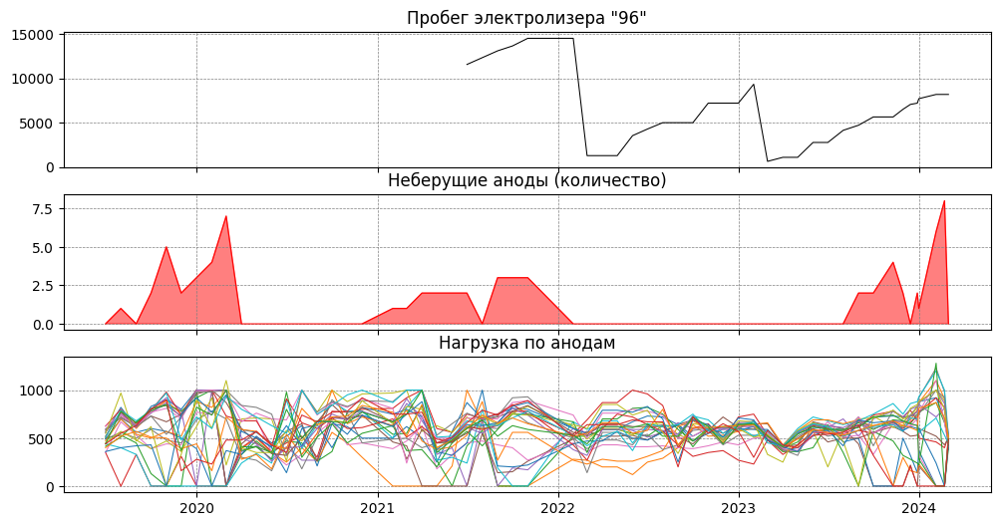

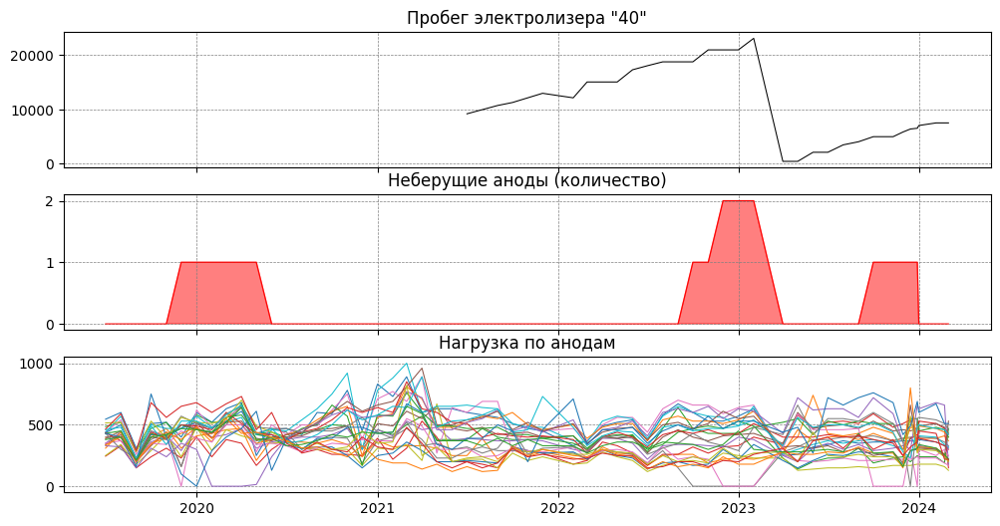

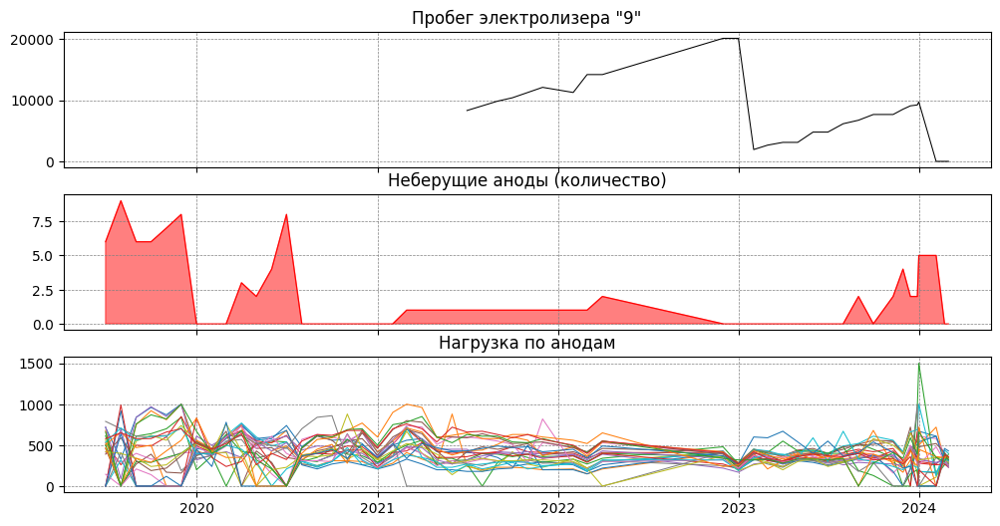

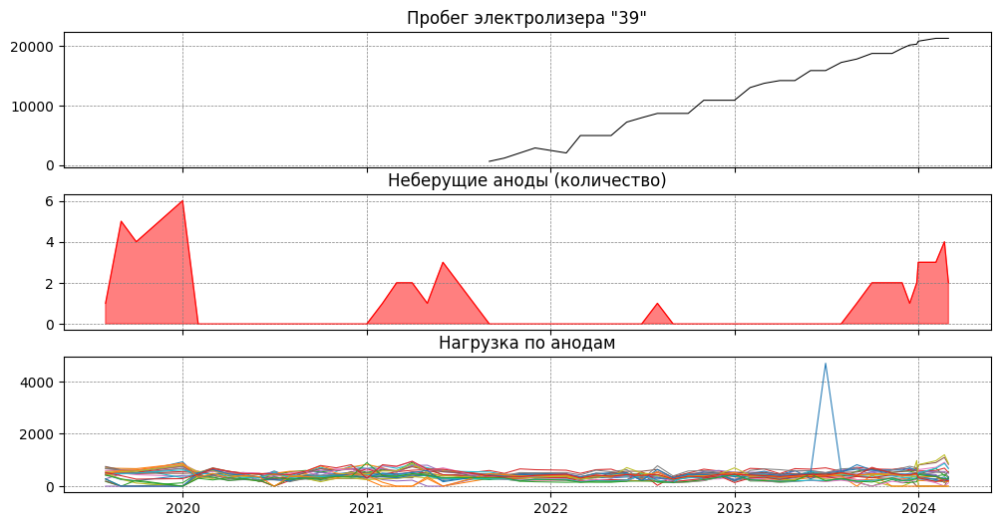

In [ ]:
for el in set(payload.el):
  DrawElState(el)

In [ ]:
pd.DataFrame(df, columns = ['dt', 'avg_press'])
#df
#AvgPress(df[df.dt == '2020-08-01'])

In [ ]:
df[df.dt == '2019-07-01']
#sorted(set(df.dt))
df

,dt,el,anod,el_anod,pres,priznak,share,el_pres_sum,break_count,probeg,dt_zamer,part,covers_count,cover_num,row,is_break
dt,,,,,,,,,,,,,,,,
2019-07-01,2019-07-01,22,1,22_1,410.0,работает,0.040482,10128.0,0.0,NaN,NaN,NaN,2,1,1,работает
2019-07-01,2019-07-01,22,3,22_3,640.0,работает,0.063191,10128.0,0.0,NaN,NaN,NaN,2,1,1,работает
2019-07-01,2019-07-01,22,23,22_23,375.0,работает,0.037026,10128.0,0.0,NaN,NaN,NaN,2,2,5,не работал
2019-07-01,2019-07-01,22,4,22_4,450.0,работает,0.044431,10128.0,0.0,NaN,NaN,NaN,2,1,2,работает
2019-07-01,2019-07-01,22,22,22_22,410.0,работает,0.040482,10128.0,0.0,NaN,NaN,NaN,2,2,5,не работал
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-03-01,2024-03-01,22,19,22_19,270.0,работает,0.034839,7750.0,0.0,2976.0,NaN,пропитка,2,2,6,не работал
2024-03-01,2024-03-01,22,20,22_20,370.0,работает,0.047742,7750.0,0.0,2976.0,NaN,пропитка,2,2,6,работает
2024-03-01,2024-03-01,22,21,22_21,480.0,работает,0.061935,7750.0,0.0,2976.0,NaN,пропитка,2,2,6,не работал


In [ ]:
set(df[df.priznak == 'неберущий'].dt)
df.reset_index(drop=True, inplace = True)


m_date = list(df.groupby('dt'))[5][1]
m_date.is_break
m_date

def AvgPress(el_date_test):
  working_press = [pres for pres, work in zip(m_date.pres, m_date.is_break) if work == 'работает']
  return len(working_press) == 0 and 0 or sum(working_press)/len(working_press)

[pres for pres, work in zip(m_date.pres, m_date.is_break) if work == 'работает']
#df.groupby('dt')

AvgPress(m_date)
sum([840.0, 400.0, 300.0, 400.0, 410.0, 280.0, 720.0, 250.0])/8

450.0

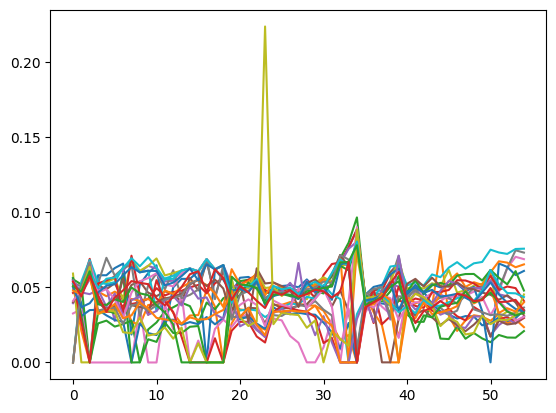

In [ ]:
df = DrawPropChange('61', 'share')

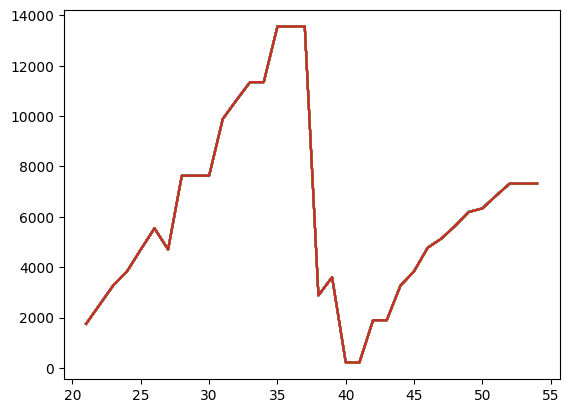

In [ ]:
df = DrawPropChange('61', 'probeg')

<Axes: >

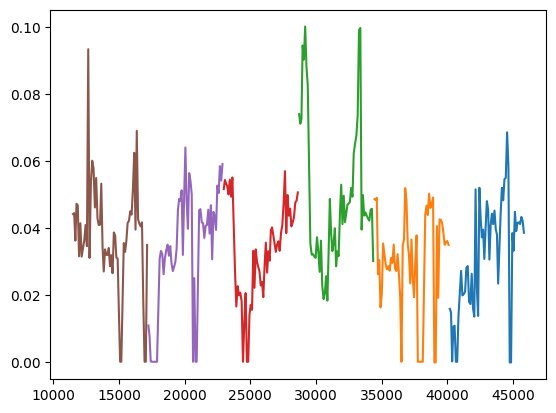

In [ ]:
#payload[payload['is_break'] == 'не работал']
payload.is_break.value_counts()
payload.el_anod.value_counts()[0:50]
#payload[payload.probeg == 0]
payload.el.value_counts()
set(payload.dt)
set(payload.cover_num)
payload.priznak.value_counts()
payload[payload['priznak'] == 'неберущий'].anod.value_counts()
payload.el_anod.value_counts()
payload.is_break.value_counts()
payload[payload['priznak'] == '<=100'].el_anod.value_counts()[:50]
payload.priznak.value_counts()
payload[payload['priznak'] == 'работает'].break_count.value_counts()
payload[payload['el_anod'] == '28а_8'].priznak.value_counts()
#list(map(float, payload[payload['el_anod'] == '28а_8'].share))

payload[payload['el_anod'] == '28а_8'].share.plot()
payload[payload['el_anod'] == '28а_7'].share.plot()
payload[payload['el_anod'] == '28а_6'].share.plot()
payload[payload['el_anod'] == '28а_5'].share.plot()
payload[payload['el_anod'] == '28а_4'].share.plot()
payload[payload['el_anod'] == '28а_3'].share.plot()


In [ ]:
repair.el.value_counts()
repair[repair.el == '65']

,el,type,reason,from_date,to_date,duration
114,65,ГР,Негерметичен колокол,2024-02-03,2024-02-04,1
133,65,КР,Разрушение анодов,2024-05-06,2024-05-08,2


In [ ]:
repair[repair.el == '28а']

,el,type,reason,from_date,to_date,duration
57,28а,КР,Разрушение анодов,2023-09-06,2023-09-07,1
126,28а,ГР,Негерметичен колокол,2024-04-23,2024-04-24,1


In [ ]:
repair

,el,type,reason,from_date,to_date,duration
0,14,КР,Разрушение анодов,2023-01-26,2023-01-27,1
1,23,КР,Разрушение анодов,2023-01-12,2023-01-14,2
2,98,КР,Негерметичность теплообменника,2023-01-15,2023-01-20,5
3,17,КР,Разрушение анодов,2023-02-22,2023-03-01,7
4,22,КР,Частые анодные эффекты,2023-02-19,2023-02-21,2
...,...,...,...,...,...,...
155,62,ГР,Негерметичен колокол,2024-08-17,2024-08-18,1
156,66,ГР,Негерметичен колокол,2024-08-31,2024-09-01,1
157,67,КР,Разрушение анодов,2024-08-26,2024-08-28,2
158,70,КР,Разрушение анодов,2024-08-22,2024-08-24,2


In [ ]:
len(set(repair.el))

94

In [ ]:
repair.el.value_counts()

,count
el,
104,4
81,4
88,4
66,4
69,3
...,...
92,1
6а,1
43,1


In [ ]:
repair.reason.value_counts()

,count
reason,
Разрушение анодов,84
Негерметичен колокол,39
Частые анодные эффекты,25
Негерметичность теплообменника,8
Напряжение выше нормы,2
Большой унос электролита,1
Замена теплообменника по пробегу,1


In [ ]:
df1 = pd.read_csv('/content/drive/MyDrive/data_el/Нагрузка на эл..csv')
df2 = pd.read_csv('/content/drive/MyDrive/data_el/Ремонты.csv')

# Объединение таблиц по столбцу 'key' (или любому другому признаку)
# Метод merge по умолчанию выполняет inner join, если нужно, можешь изменить параметр how
merged_df = pd.merge(df1, df2, on='el', how='inner')

# Сохранение результата в новый CSV файл
merged_df.to_csv('merged_table.csv', index=False)
merged_df

,month,year,dt,el,anod,el_anod,pres,priznak,share,el_pres_sum,...,part,covers_count,cover_num,row,is_break,type,reason,from_date,to_date,duration
0,7,2019,2019-07-01,1,1,1_1,809.0,работает,0.083505367464905,9688.0,...,NaN,2,1,1,не работал,КР,Разрушение анодов,2023-06-26,2023-06-27,1
1,7,2019,2019-07-01,2,1,2_1,380.0,работает,0.0382178416976768,9943.0,...,NaN,2,1,1,не работал,ГР,Негерметичен колокол,2024-07-08,2024-07-09,1
2,7,2019,2019-07-01,3,1,3_1,715.0,работает,0.0741547396805642,9642.0,...,NaN,2,1,1,работает,КР,Разрушение анодов,2024-01-28,2024-01-29,1
3,7,2019,2019-07-01,4,1,4_1,370.0,работает,0.04052573932092,9130.0,...,NaN,2,1,1,работает,КР,Большой унос электролита,2023-05-17,2023-05-19,2
4,7,2019,2019-07-01,4,1,4_1,370.0,работает,0.04052573932092,9130.0,...,NaN,2,1,1,работает,КР,Частые анодные эффекты,2024-04-20,2024-04-23,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
206539,3,2024,2024-03-01,99,24,99_24,490.0,работает,0.042720139494333,11470.0,...,NaN,4,4,4,не работал,КР,Частые анодные эффекты,2023-10-09,2023-10-10,1
206540,3,2024,2024-03-01,100,24,100_24,510.0,работает,0.0435153583617747,11720.0,...,NaN,4,4,4,не работал,КР,Разрушение анодов,2023-12-14,2023-12-15,1
206541,3,2024,2024-03-01,101,24,101_24,480.0,работает,0.0422907488986784,11350.0,...,NaN,4,4,4,работает,ГР,Частые анодные эффекты,2023-02-09,2023-02-17,8
206542,3,2024,2024-03-01,101,24,101_24,480.0,работает,0.0422907488986784,11350.0,...,NaN,4,4,4,работает,ГР,Негерметичен колокол,2023-02-22,2023-02-23,1


In [ ]:
df1

,month,year,dt,el,anod,el_anod,pres,priznak,share,el_pres_sum,break_count,probeg,dt_zamer,part,covers_count,cover_num,row,is_break
0,7,2019,2019-07-01,1,1,1_1,809.0,работает,0.083505367464905,9688.0,3.0,NaN,NaN,NaN,2,1,1,не работал
1,7,2019,2019-07-01,2,1,2_1,380.0,работает,0.0382178416976768,9943.0,0.0,NaN,NaN,NaN,2,1,1,не работал
2,7,2019,2019-07-01,3,1,3_1,715.0,работает,0.0741547396805642,9642.0,1.0,NaN,NaN,NaN,2,1,1,работает
3,7,2019,2019-07-01,4,1,4_1,370.0,работает,0.04052573932092,9130.0,0.0,NaN,NaN,NaN,2,1,1,работает
4,7,2019,2019-07-01,5,1,5_1,230.0,работает,0.0239458615304529,9605.0,0.0,NaN,NaN,NaN,2,1,1,работает
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
137659,3,2024,2024-03-01,96,24,96_24,490.0,работает,0.0430201931518876,11390.0,0.0,8184.0,NaN,NaN,4,4,4,не работал
137660,3,2024,2024-03-01,98,24,98_24,470.0,работает,0.040905134899913,11490.0,0.0,2640.0,NaN,NaN,4,4,4,не работал
137661,3,2024,2024-03-01,99,24,99_24,490.0,работает,0.042720139494333,11470.0,0.0,2880.0,NaN,NaN,4,4,4,не работал
137662,3,2024,2024-03-01,100,24,100_24,510.0,работает,0.0435153583617747,11720.0,0.0,1296.0,NaN,NaN,4,4,4,не работал


In [ ]:
df2


,el,type,reason,from_date,to_date,duration
0,14,КР,Разрушение анодов,2023-01-26,2023-01-27,1
1,23,КР,Разрушение анодов,2023-01-12,2023-01-14,2
2,98,КР,Негерметичность теплообменника,2023-01-15,2023-01-20,5
3,17,КР,Разрушение анодов,2023-02-22,2023-03-01,7
4,22,КР,Частые анодные эффекты,2023-02-19,2023-02-21,2
...,...,...,...,...,...,...
155,62,ГР,Негерметичен колокол,2024-08-17,2024-08-18,1
156,66,ГР,Негерметичен колокол,2024-08-31,2024-09-01,1
157,67,КР,Разрушение анодов,2024-08-26,2024-08-28,2
158,70,КР,Разрушение анодов,2024-08-22,2024-08-24,2


In [ ]:
merged_df.head(10)

,month,year,dt,el,anod,el_anod,pres,priznak,share,el_pres_sum,...,part,covers_count,cover_num,row,is_break,type,reason,from_date,to_date,duration
0,7,2019,2019-07-01,1,1,1_1,809.0,работает,0.083505367464905,9688.0,...,NaN,2,1,1,не работал,КР,Разрушение анодов,2023-06-26,2023-06-27,1
1,7,2019,2019-07-01,2,1,2_1,380.0,работает,0.0382178416976768,9943.0,...,NaN,2,1,1,не работал,ГР,Негерметичен колокол,2024-07-08,2024-07-09,1
2,7,2019,2019-07-01,3,1,3_1,715.0,работает,0.0741547396805642,9642.0,...,NaN,2,1,1,работает,КР,Разрушение анодов,2024-01-28,2024-01-29,1
3,7,2019,2019-07-01,4,1,4_1,370.0,работает,0.04052573932092,9130.0,...,NaN,2,1,1,работает,КР,Большой унос электролита,2023-05-17,2023-05-19,2
4,7,2019,2019-07-01,4,1,4_1,370.0,работает,0.04052573932092,9130.0,...,NaN,2,1,1,работает,КР,Частые анодные эффекты,2024-04-20,2024-04-23,3
5,7,2019,2019-07-01,40,1,40_1,545.0,работает,0.0569190600522193,9575.0,...,NaN,2,1,1,работает,КР,Частые анодные эффекты,2023-03-30,2023-03-31,1
6,7,2019,2019-07-01,40,1,40_1,545.0,работает,0.0569190600522193,9575.0,...,NaN,2,1,1,работает,КР,Частые анодные эффекты,2023-03-21,2023-03-31,10
7,7,2019,2019-07-01,6а,1,6а_1,530.0,работает,0.0552947313510694,9585.0,...,NaN,2,1,1,работает,КР,Разрушение анодов,2023-12-17,2023-12-18,1
8,7,2019,2019-07-01,6,1,6_1,290.0,работает,0.0304046970014678,9538.0,...,NaN,2,1,1,работает,ГР,Негерметичен колокол,2023-04-18,2023-04-19,1
9,7,2019,2019-07-01,6,1,6_1,290.0,работает,0.0304046970014678,9538.0,...,NaN,2,1,1,работает,ГР,Частые анодные эффекты,2023-12-15,2023-12-16,1


In [ ]:
merged_df[merged_df['el'] == '1']

,month,year,dt,el,anod,el_anod,pres,priznak,share,el_pres_sum,...,part,covers_count,cover_num,row,is_break,type,reason,from_date,to_date,duration
0,7,2019,2019-07-01,1,1,1_1,809.0,работает,0.083505367464905,9688.0,...,NaN,2,1,1,не работал,КР,Разрушение анодов,2023-06-26,2023-06-27,1
132,8,2019,2019-08-01,1,1,1_1,720.0,работает,0.075685903500473,9513.0,...,NaN,2,1,1,не работал,КР,Разрушение анодов,2023-06-26,2023-06-27,1
264,9,2019,2019-09-01,1,1,1_1,420.0,работает,0.0496747486694264,8455.0,...,NaN,2,1,1,не работал,КР,Разрушение анодов,2023-06-26,2023-06-27,1
542,11,2019,2019-11-01,1,1,1_1,410.0,работает,0.0434322033898305,9440.0,...,NaN,2,1,1,не работал,КР,Разрушение анодов,2023-06-26,2023-06-27,1
692,12,2019,2019-12-01,1,1,1_1,440.0,работает,0.0471092077087794,9340.0,...,NaN,2,1,1,не работал,КР,Разрушение анодов,2023-06-26,2023-06-27,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
205806,12,2023,2023-12-29,1,24,1_24,140.0,работает,0.0133817625692984,10462.0,...,п,2,2,5,не работал,КР,Разрушение анодов,2023-06-26,2023-06-27,1
205952,1,2024,2024-01-01,1,24,1_24,250.0,работает,0.0253807106598985,9850.0,...,п,2,2,5,не работал,КР,Разрушение анодов,2023-06-26,2023-06-27,1
206103,2,2024,2024-02-05,1,24,1_24,230.0,работает,0.0246781115879828,9320.0,...,п,2,2,5,не работал,КР,Разрушение анодов,2023-06-26,2023-06-27,1
206252,2,2024,2024-02-22,1,24,1_24,280.0,работает,0.0334928229665072,8360.0,...,п,2,2,5,не работал,КР,Разрушение анодов,2023-06-26,2023-06-27,1


In [ ]:
merged_df['new_column'] = merged_df['reason'].apply(lambda x: 1 if x == 'Разрушение анодов' else 0)

In [ ]:
merged_df

,month,year,dt,el,anod,el_anod,pres,priznak,share,el_pres_sum,...,covers_count,cover_num,row,is_break,type,reason,from_date,to_date,duration,new_column
0,7,2019,2019-07-01,1,1,1_1,809.0,работает,0.083505367464905,9688.0,...,2,1,1,не работал,КР,Разрушение анодов,2023-06-26,2023-06-27,1,1
1,7,2019,2019-07-01,2,1,2_1,380.0,работает,0.0382178416976768,9943.0,...,2,1,1,не работал,ГР,Негерметичен колокол,2024-07-08,2024-07-09,1,0
2,7,2019,2019-07-01,3,1,3_1,715.0,работает,0.0741547396805642,9642.0,...,2,1,1,работает,КР,Разрушение анодов,2024-01-28,2024-01-29,1,1
3,7,2019,2019-07-01,4,1,4_1,370.0,работает,0.04052573932092,9130.0,...,2,1,1,работает,КР,Большой унос электролита,2023-05-17,2023-05-19,2,0
4,7,2019,2019-07-01,4,1,4_1,370.0,работает,0.04052573932092,9130.0,...,2,1,1,работает,КР,Частые анодные эффекты,2024-04-20,2024-04-23,3,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
206539,3,2024,2024-03-01,99,24,99_24,490.0,работает,0.042720139494333,11470.0,...,4,4,4,не работал,КР,Частые анодные эффекты,2023-10-09,2023-10-10,1,0
206540,3,2024,2024-03-01,100,24,100_24,510.0,работает,0.0435153583617747,11720.0,...,4,4,4,не работал,КР,Разрушение анодов,2023-12-14,2023-12-15,1,1
206541,3,2024,2024-03-01,101,24,101_24,480.0,работает,0.0422907488986784,11350.0,...,4,4,4,работает,ГР,Частые анодные эффекты,2023-02-09,2023-02-17,8,0
206542,3,2024,2024-03-01,101,24,101_24,480.0,работает,0.0422907488986784,11350.0,...,4,4,4,работает,ГР,Негерметичен колокол,2023-02-22,2023-02-23,1,0


In [ ]:
merged_df[merged_df['el'] == '1']

,month,year,dt,el,anod,el_anod,pres,priznak,share,el_pres_sum,...,covers_count,cover_num,row,is_break,type,reason,from_date,to_date,duration,new_column
0,7,2019,2019-07-01,1,1,1_1,809.0,работает,0.083505367464905,9688.0,...,2,1,1,не работал,КР,Разрушение анодов,2023-06-26,2023-06-27,1,1
132,8,2019,2019-08-01,1,1,1_1,720.0,работает,0.075685903500473,9513.0,...,2,1,1,не работал,КР,Разрушение анодов,2023-06-26,2023-06-27,1,1
264,9,2019,2019-09-01,1,1,1_1,420.0,работает,0.0496747486694264,8455.0,...,2,1,1,не работал,КР,Разрушение анодов,2023-06-26,2023-06-27,1,1
542,11,2019,2019-11-01,1,1,1_1,410.0,работает,0.0434322033898305,9440.0,...,2,1,1,не работал,КР,Разрушение анодов,2023-06-26,2023-06-27,1,1
692,12,2019,2019-12-01,1,1,1_1,440.0,работает,0.0471092077087794,9340.0,...,2,1,1,не работал,КР,Разрушение анодов,2023-06-26,2023-06-27,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
205806,12,2023,2023-12-29,1,24,1_24,140.0,работает,0.0133817625692984,10462.0,...,2,2,5,не работал,КР,Разрушение анодов,2023-06-26,2023-06-27,1,1
205952,1,2024,2024-01-01,1,24,1_24,250.0,работает,0.0253807106598985,9850.0,...,2,2,5,не работал,КР,Разрушение анодов,2023-06-26,2023-06-27,1,1
206103,2,2024,2024-02-05,1,24,1_24,230.0,работает,0.0246781115879828,9320.0,...,2,2,5,не работал,КР,Разрушение анодов,2023-06-26,2023-06-27,1,1
206252,2,2024,2024-02-22,1,24,1_24,280.0,работает,0.0334928229665072,8360.0,...,2,2,5,не работал,КР,Разрушение анодов,2023-06-26,2023-06-27,1,1


In [ ]:
merged_df.sample(5)

,month,year,dt,el,anod,el_anod,pres,priznak,share,el_pres_sum,...,covers_count,cover_num,row,is_break,type,reason,from_date,to_date,duration,new_column
49525,4,2023,2023-04-01,80,6,80_6,450.0,работает,0.0462487153134635,9730.0,...,4,1,1,не работал,КР,Разрушение анодов,2023-02-05,2023-02-07,2,1
204708,6,2023,2023-06-01,104,24,104_24,730.0,работает,0.0522922636103152,13960.0,...,4,4,4,не работал,КР,Частые анодные эффекты,2023-03-23,2023-03-25,2,0
118227,3,2023,2023-03-01,79,14,79_14,650.0,работает,0.0470673425054308,13810.0,...,4,3,3,не работал,КР,Разрушение анодов,2023-12-29,2023-12-29,0,1
119727,12,2023,2023-12-15,85,14,85_14,730.0,работает,0.0524048815506102,13930.0,...,4,3,3,работает,КР,Негерметичность теплообменника,2023-08-14,2023-08-18,4,0
205054,8,2023,2023-08-01,97,24,97_24,540.0,работает,0.0476190476190476,11340.0,...,4,4,4,не работал,КР,Негерметичен колокол,2024-04-16,2024-04-17,1,0
